In [ ]:
import praw
import os
from PIL import Image, UnidentifiedImageError
import random
import requests
import matplotlib.pyplot as plt

from skimage.io import imread
from sklearn.metrics import ConfusionMatrixDisplay, recall_score, precision_score, accuracy_score
from PIL import Image
from transformers import CLIPTokenizer, CLIPProcessor, CLIPModel
import matplotlib.pyplot as plt
import torch
from random import choice

%matplotlib inline
%load_ext autoreload
%autoreload 2

In [ ]:
reddit = praw.Reddit(
    client_id=os.getenv("REDDIT_CLIENT_ID"),
    client_secret=os.getenv("REDDIT_CLIENT_SECRET"),
    user_agent="/u/ManticFox bot",
)

In [ ]:
reddit.read_only

In [ ]:
subs = list(reddit.subreddit("awww").top(limit=1000, time_filter="year"))
subs = [s for s in subs if ".jpg" in s.url or ".png" in s.url]
len(subs)

In [ ]:
for s in subs[:10]:
    print(s.title)
    print(s.permalink)
    print(s.url)
    print()

In [ ]:
s = subs[3]
im = Image.open(requests.get(s.url, stream=True).raw)
plt.imshow(im)
plt.show()

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")
tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-base-patch32")
model.to(device)
device

In [ ]:
#     model.get_text_features
s = subs[3]
image = Image.open(requests.get(s.url, stream=True).raw)
title = s.title
title

In [ ]:
with torch.no_grad():
    inputs = processor(images=image, return_tensors="pt", padding=True).to(device)
    image_features = model.get_image_features(**inputs).cpu().numpy()
    inputs = tokenizer(title, padding=True, return_tensors="pt").to(device)
    text_features = model.get_text_features(**inputs).cpu().numpy()
text_features.shape, image_features.shape

In [ ]:
text_features.dot(image_features.T)

In [ ]:
with torch.no_grad():
    inputs = tokenizer("Before and after of a white cat", padding=True, return_tensors="pt").to(device)
    text_features = model.get_text_features(**inputs).cpu().numpy()
text_features.dot(image_features.T)

In [ ]:
with torch.no_grad():
    inputs = tokenizer("Dog playing in the bath", padding=True, return_tensors="pt").to(device)
    text_features = model.get_text_features(**inputs).cpu().numpy()
text_features.dot(image_features.T)

In [ ]:
with torch.no_grad():
    inputs = tokenizer("a photo of a white cat", padding=True, return_tensors="pt").to(device)
    text_features = model.get_text_features(**inputs).cpu().numpy()
text_features.dot(image_features.T)

In [ ]:
images =  []
failures = []

for idx, s in enumerate(subs):
    if idx % 50 == 0:
        print(idx)
    try:
        images.append(Image.open(requests.get(s.url, stream=True).raw).resize((512, 512)))
    except UnidentifiedImageError:
        print(s.title)
        print(idx)
        failures.append(idx)
    except Exception as e:
        print(e)
        print(s.title)
        print(idx)
        failures.append(idx)
plt.imshow(images[0])

In [ ]:
subs[2].url

In [ ]:
subs.pop(2)

In [ ]:
len(subs), len(images)

In [ ]:
with torch.no_grad():
    inputs = processor(images=images, return_tensors="pt", padding=True).to(device)
    images_features = model.get_image_features(**inputs).cpu().numpy()
images_features.shape

In [ ]:
def show_top_6_posts(search_query):
    with torch.no_grad():
        inputs = tokenizer(search_query, padding=True, return_tensors="pt").to(device)
        text_features = model.get_text_features(**inputs).cpu().numpy()
    fig, axes = plt.subplots(2, 3, figsize=(20, 20))
    i = 0
    simalarities = text_features.dot(images_features.T)
    for idx in simalarities.argsort()[0, ::-1][:6]:
        row, col = i // 3, i % 3
        s = subs[idx]
        sim = simalarities[0, idx]
        img = Image.open(requests.get(s.url, stream=True).raw)
        axes[row][col].imshow(img)
        axes[row][col].set_title(f"{s.title} - {sim:.2f}")
        axes[row][col].axes.xaxis.set_visible(False)
        axes[row][col].axes.yaxis.set_visible(False)
        i += 1    
    plt.tight_layout()

In [ ]:
show_top_6_posts("a photo of a white cat")

In [ ]:
show_top_6_posts("Before and after of a white cat")

In [ ]:
s = random.choice(subs)
plt.imshow(Image.open(requests.get(s.url, stream=True).raw))
plt.title(s.title)

In [ ]:
show_top_6_posts("Dog greeting a monk")

In [ ]:
s = random.choice(subs)
plt.imshow(Image.open(requests.get(s.url, stream=True).raw))
plt.title(s.title)

In [ ]:
show_top_6_posts("Cat in a pot")

In [ ]:
s = random.choice(subs)
plt.imshow(Image.open(requests.get(s.url, stream=True).raw))
plt.title(s.title)

In [ ]:
show_top_6_posts("praise the sun")

In [ ]:
show_top_6_posts("baby praise the sun")

# Different subreddit - "funny"

In [ ]:
funny_posts = list(reddit.subreddit("funny").top(limit=1000, time_filter="year"))
print(len(funny_posts))
funny_posts = [p for p in funny_posts if ".jpg" in p.url or ".png" in p.url]
len(funny_posts)

In [ ]:
images =  []
failures = []

for idx, p in enumerate(funny_posts):
    if idx % 50 == 0:
        print(idx)
    try:
        images.append(Image.open(requests.get(p.url, stream=True).raw).resize((512, 512)))
    except UnidentifiedImageError:
        print(idx, p.title, p.url)
        failures.append(idx)
    except Exception as e:
        print(e)
        print(idx, p.title, p.url)
        failures.append(idx)
plt.imshow(images[0])

In [ ]:
len(funny_posts), len(failures)

In [ ]:
with torch.no_grad():
    inputs = processor(images=images, return_tensors="pt", padding=True).to(device)
    funny_features = model.get_image_features(**inputs).cpu().numpy()
funny_features.shape

In [ ]:
def show_top_6_funny_posts(search_query):
    with torch.no_grad():
        inputs = tokenizer(search_query, padding=True, return_tensors="pt").to(device)
        text_features = model.get_text_features(**inputs).cpu().numpy()
    fig, axes = plt.subplots(2, 3, figsize=(20, 20))
    i = 0
    simalarities = text_features.dot(funny_features.T)
    for idx in simalarities.argsort()[0, ::-1][:6]:
        row, col = i // 3, i % 3
        p = funny_posts[idx]
        sim = simalarities[0, idx]
        img = Image.open(requests.get(p.url, stream=True).raw)
        axes[row][col].imshow(img)
        axes[row][col].set_title(f"{p.title} - {sim:.2f}")
        axes[row][col].axes.xaxis.set_visible(False)
        axes[row][col].axes.yaxis.set_visible(False)
        i += 1    
    plt.tight_layout()

In [ ]:
def show_random_post():
    p = random.choice(funny_posts)
    plt.imshow(Image.open(requests.get(p.url, stream=True).raw))
    plt.title(p.title)

In [ ]:
show_random_post()

In [ ]:
show_top_6_funny_posts("christmas tree selfie")

In [ ]:
show_random_post()

In [ ]:
show_top_6_funny_posts("disgusting food in a pan")

In [ ]:
show_random_post()

In [ ]:
show_top_6_funny_posts("comic talking to boss")

# Comics Subreddit

In [ ]:
comic_posts = list(reddit.subreddit("comics").top(limit=1000, time_filter="year"))
print(len(comic_posts))
comic_posts = [p for p in comic_posts if ".jpg" in p.url or ".png" in p.url]
len(comic_posts)

In [ ]:
images =  []
failures = []

for idx, p in enumerate(comic_posts):
    if idx % 50 == 0:
        print(idx)
    try:
        images.append(Image.open(requests.get(p.url, stream=True).raw).resize((512, 512)))
    except UnidentifiedImageError:
        print(idx, p.title, p.url)
        failures.append(idx)
    except Exception as e:
        print(e)
        print(idx, p.title, p.url)
        failures.append(idx)
plt.imshow(images[0])

In [ ]:
failures
while len(failures) > 0:
    fail_idx = failures.pop()
    comic_posts.pop(fail_idx)
len(comic_posts), len(images)

In [ ]:
with torch.no_grad():
    inputs = processor(images=images, return_tensors="pt", padding=True).to(device)
    comics_features = model.get_image_features(**inputs).cpu().numpy()
comics_features.shape

In [ ]:
def show_top_6_comics_posts(search_query):
    with torch.no_grad():
        inputs = tokenizer(search_query, padding=True, return_tensors="pt").to(device)
        text_features = model.get_text_features(**inputs).cpu().numpy()
    fig, axes = plt.subplots(2, 3, figsize=(20, 20))
    i = 0
    simalarities = text_features.dot(comics_features.T)
    for idx in simalarities.argsort()[0, ::-1][:6]:
        row, col = i // 3, i % 3
        p = comic_posts[idx]
        sim = simalarities[0, idx]
        img = Image.open(requests.get(p.url, stream=True).raw)
        axes[row][col].imshow(img)
        axes[row][col].set_title(f"{p.title} - {sim:.2f}")
        axes[row][col].axes.xaxis.set_visible(False)
        axes[row][col].axes.yaxis.set_visible(False)
        i += 1    
    plt.tight_layout()
def show_random_comic():
    p = random.choice(comic_posts)
    fig, ax = plt.subplots(1, 1, figsize=(10, 10))
    plt.imshow(Image.open(requests.get(p.url, stream=True).raw))
    plt.title(p.title)

In [ ]:
show_random_comic()

In [ ]:
show_top_6_comics_posts("draw me like your french girls comic")

In [ ]:
show_random_comic()

In [ ]:
show_top_6_comics_posts("corgie and cat comic")

In [ ]:
show_random_comic()

In [ ]:
show_random_comic()

In [ ]:
show_top_6_comics_posts("calculator comic")

In [ ]:
show_top_6_comics_posts("comic")

In [ ]:
show_random_comic()

In [ ]:
show_top_6_comics_posts("sad cat")

# Pics

In [ ]:
pics_posts = list(reddit.subreddit("pics").top(limit=1000, time_filter="year"))
print(len(pics_posts))
pics_posts = [p for p in pics_posts if ".jpg" in p.url or ".png" in p.url]
print(len(pics_posts))
images =  []
for idx, p in enumerate(pics_posts):
    if idx % 50 == 0:
        print(idx)
    try:
        images.append(Image.open(requests.get(p.url, stream=True).raw).resize((512, 512)))
    except UnidentifiedImageError:
        print(idx, p.title, p.url)
        failures.append(idx)
        pics_posts.pop(idx)
    except Exception as e:
        print(e)
        print(idx, p.title, p.url)
        pics_posts.pop(idx)
print(len(images))
with torch.no_grad():
    inputs = processor(images=images, return_tensors="pt", padding=True).to(device)
    pics_features = model.get_image_features(**inputs).cpu().numpy()
pics_features.shape

In [ ]:
def show_top_6_pics_posts(search_query):
    with torch.no_grad():
        inputs = tokenizer(search_query, padding=True, return_tensors="pt").to(device)
        text_features = model.get_text_features(**inputs).cpu().numpy()
    fig, axes = plt.subplots(2, 3, figsize=(20, 20))
    i = 0
    simalarities = text_features.dot(pics_features.T)
    for idx in simalarities.argsort()[0, ::-1][:6]:
        row, col = i // 3, i % 3
        p = pics_posts[idx]
        sim = simalarities[0, idx]
        img = Image.open(requests.get(p.url, stream=True).raw)
        axes[row][col].imshow(img)
        axes[row][col].set_title(f"{p.title} - {sim:.2f}")
        axes[row][col].axes.xaxis.set_visible(False)
        axes[row][col].axes.yaxis.set_visible(False)
        i += 1    
    plt.tight_layout()
def show_random_pic():
    p = random.choice(pics_posts)
    fig, ax = plt.subplots(1, 1, figsize=(10, 10))
    plt.imshow(Image.open(requests.get(p.url, stream=True).raw))
    plt.title(p.title)

In [ ]:
show_random_pic()

In [ ]:
show_top_6_pics_posts("cruella cosplay with cats")

In [ ]:
show_random_pic()

In [ ]:
show_top_6_pics_posts("letter from the president")

In [ ]:
show_random_pic()

In [ ]:
show_top_6_pics_posts("bloody bass")

In [ ]:
show_top_6_pics_posts("bass guitar closeup")

In [ ]:
show_random_pic()

In [ ]:
show_top_6_pics_posts("man with large beard in graduation outfit")

In [ ]:
show_random_pic()

In [ ]:
show_top_6_pics_posts("stealth bomber")

In [ ]:
show_random_pic()

In [ ]:
show_top_6_pics_posts("colorful photo of power lines")

In [214]:
def show_top_6_pics_posts(search_query):
    with torch.no_grad():
        inputs = tokenizer(search_query, padding=True, return_tensors="pt").to(device)
        text_features = model.get_text_features(**inputs).cpu().numpy()
    fig, axes = plt.subplots(2, 3, figsize=(20, 20))
    i = 0
    simalarities = text_features.dot(pics_features.T)
    for idx in simalarities.argsort()[0, ::-1][:6]:
        row, col = i // 3, i % 3
        p = pics_posts[idx]
        sim = simalarities[0, idx]
        img = Image.open(requests.get(p.url, stream=True).raw)
        axes[row][col].imshow(img)
        axes[row][col].set_title(f"{p.title} - {sim:.2f}")
        axes[row][col].axes.xaxis.set_visible(False)
        axes[row][col].axes.yaxis.set_visible(False)
        i += 1    
    plt.tight_layout()
def show_random_pic():
    p = random.choice(pics_posts)
    fig, ax = plt.subplots(1, 1, figsize=(10, 10))
    plt.imshow(Image.open(requests.get(p.url, stream=True).raw))
    plt.title(p.title)

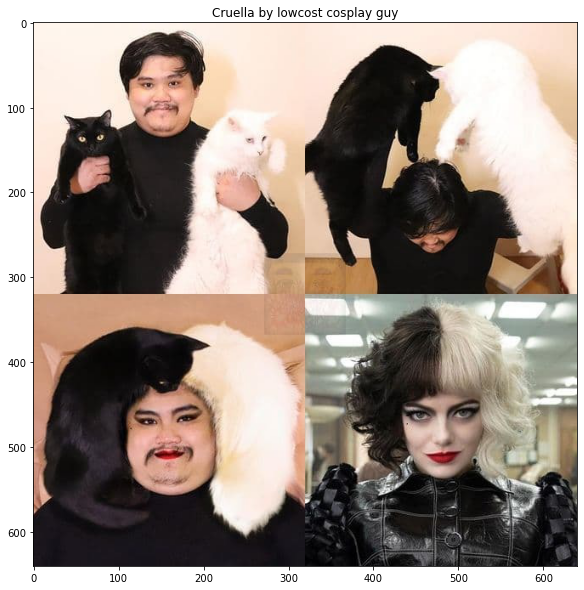

In [167]:
show_random_pic()

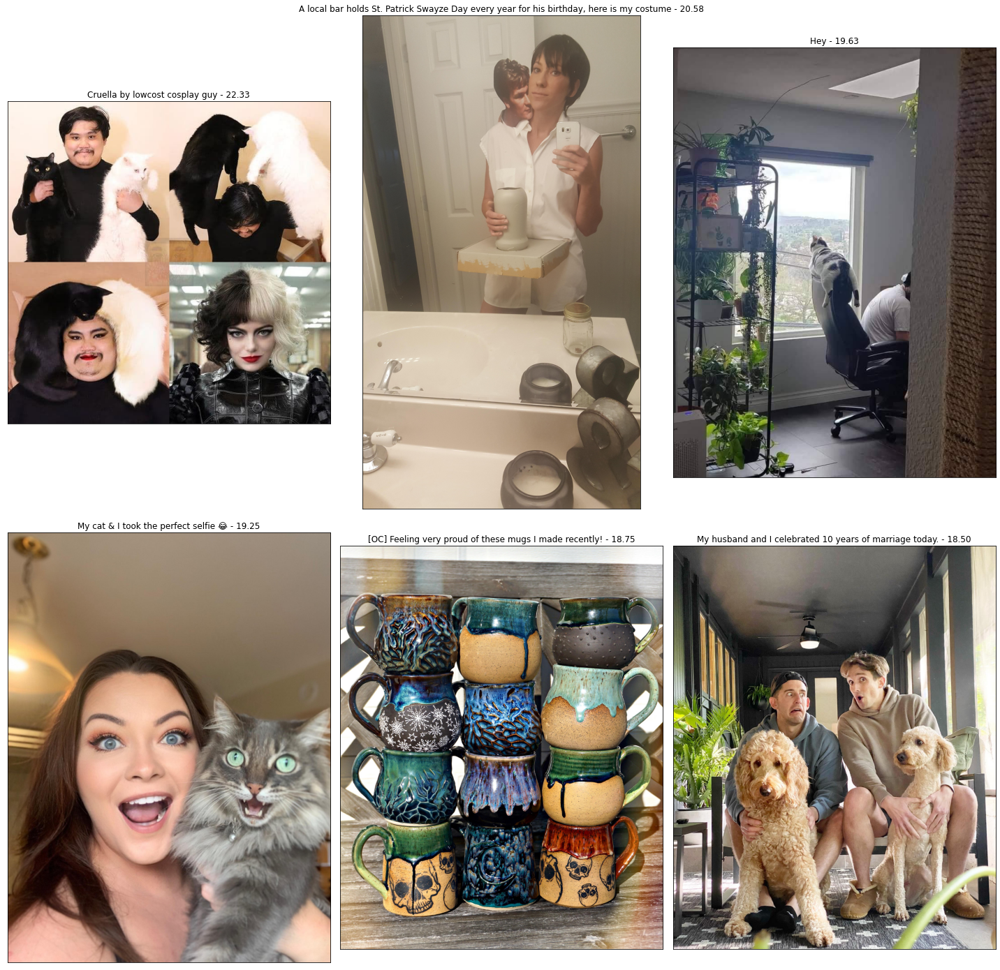

In [215]:
show_top_6_pics_posts("cruella cosplay with cats")

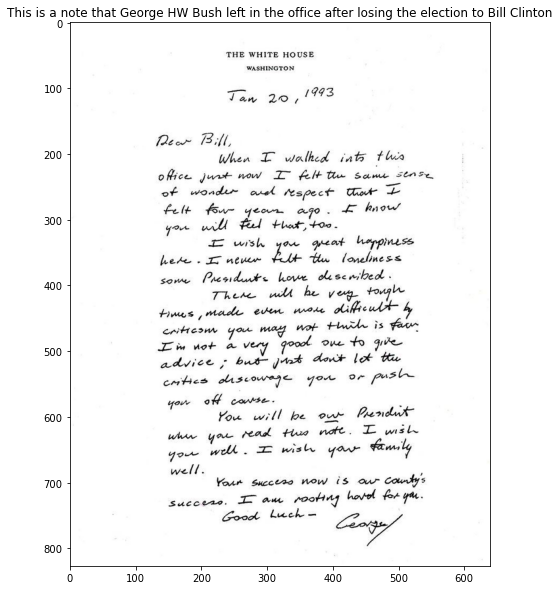

In [172]:
show_random_pic()

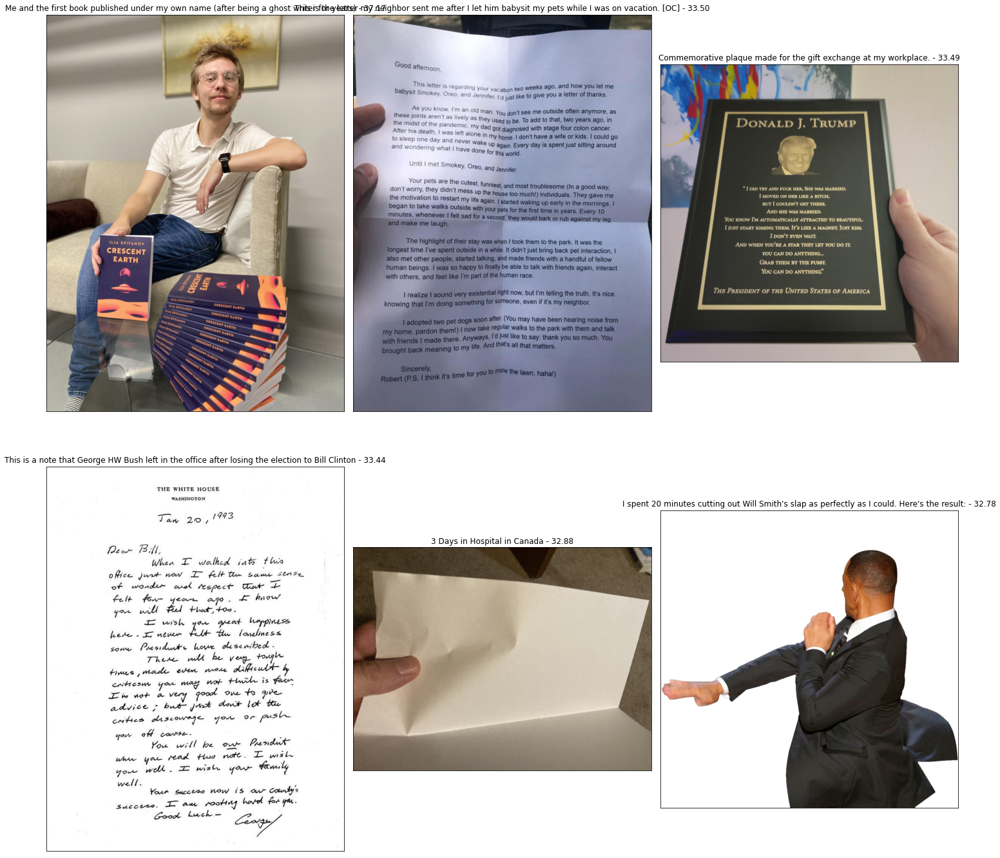

In [216]:
show_top_6_pics_posts("letter from the president")

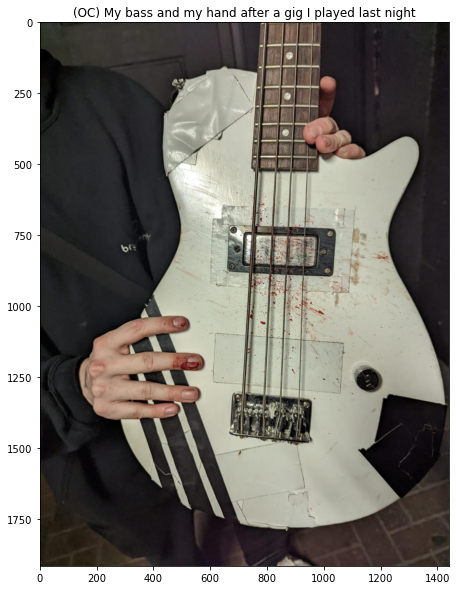

In [176]:
show_random_pic()

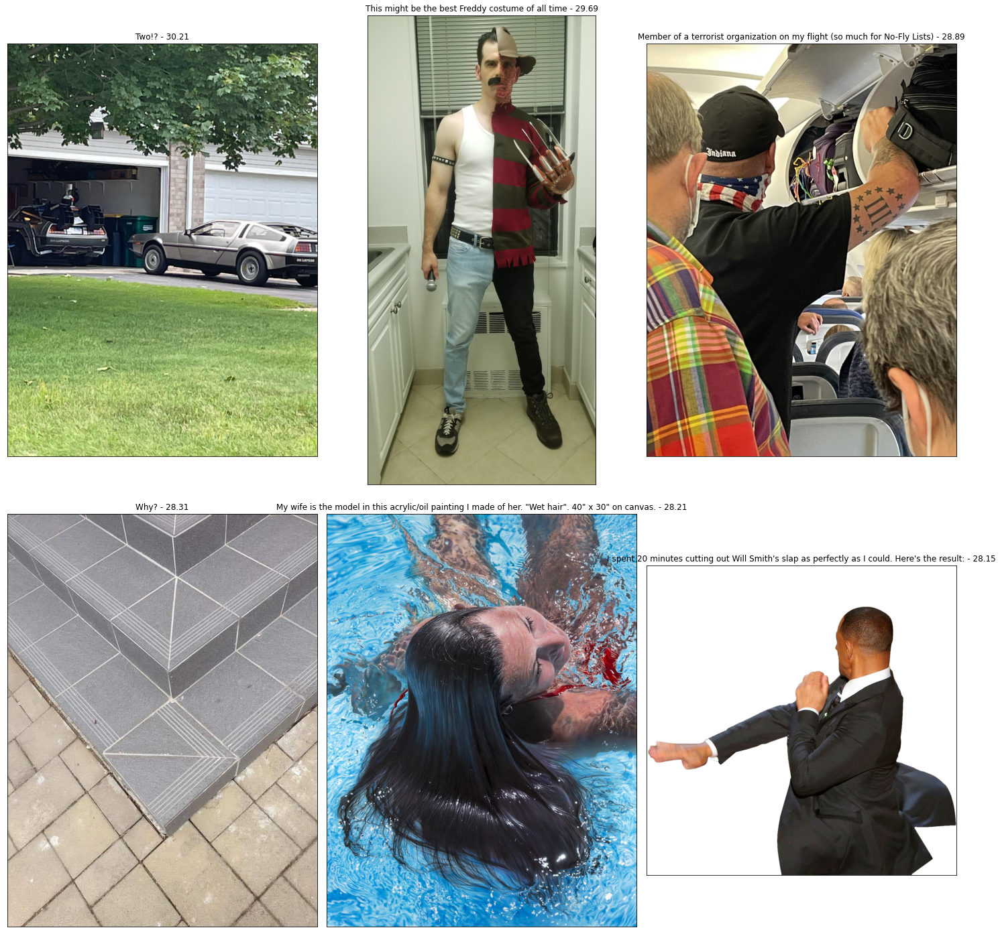

In [217]:
show_top_6_pics_posts("bloody bass")

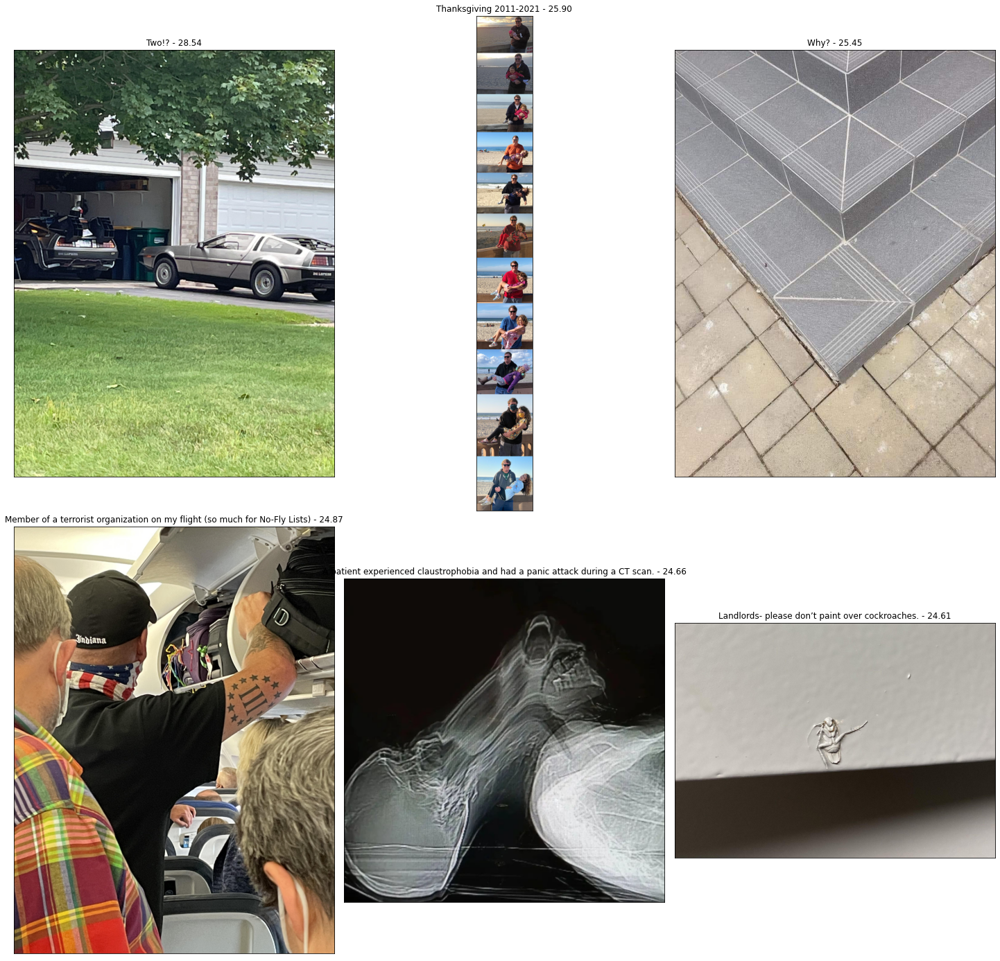

In [218]:
show_top_6_pics_posts("bass guitar closeup")

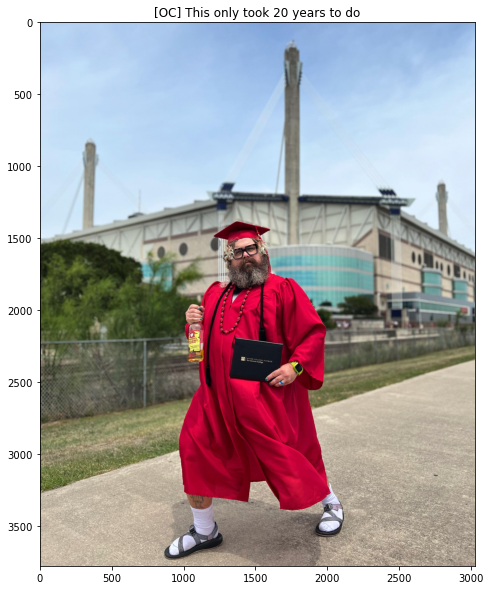

In [186]:
show_random_pic()

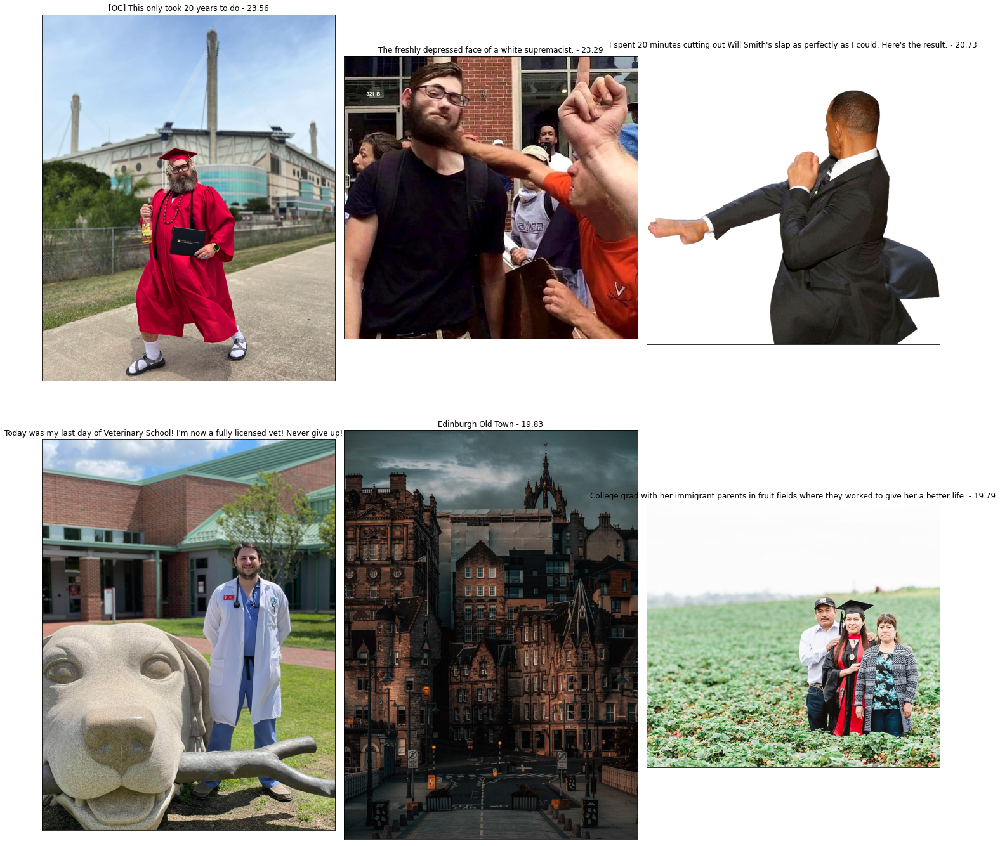

In [219]:
show_top_6_pics_posts("man with large beard in graduation outfit")

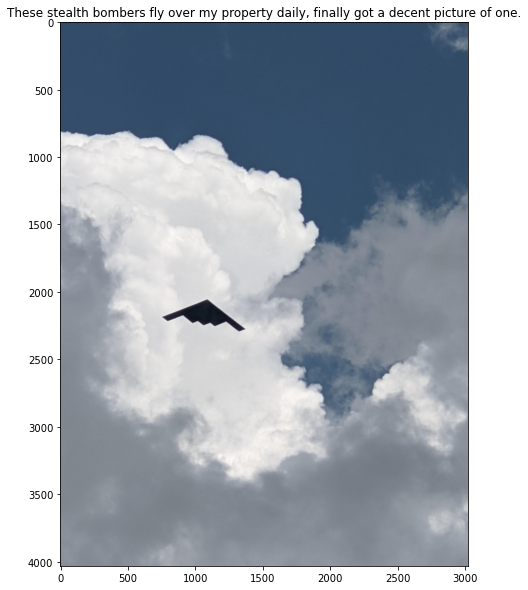

In [188]:
show_random_pic()

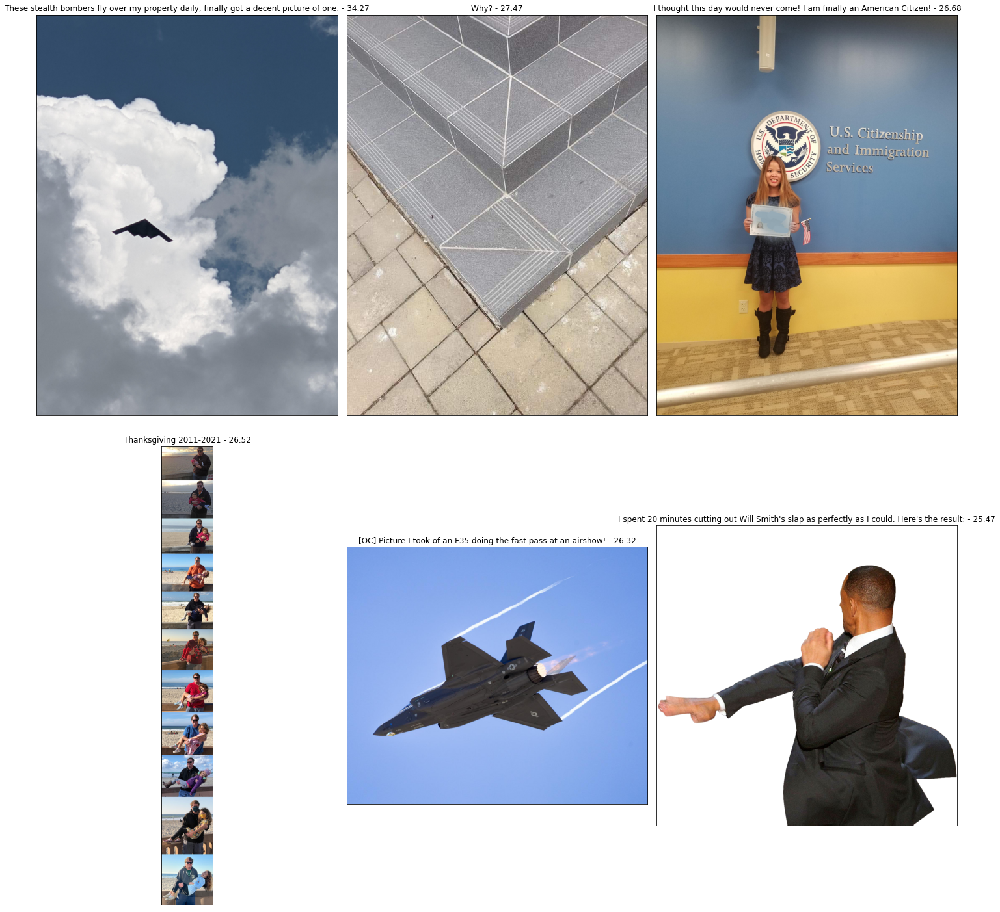

In [220]:
show_top_6_pics_posts("stealth bomber")

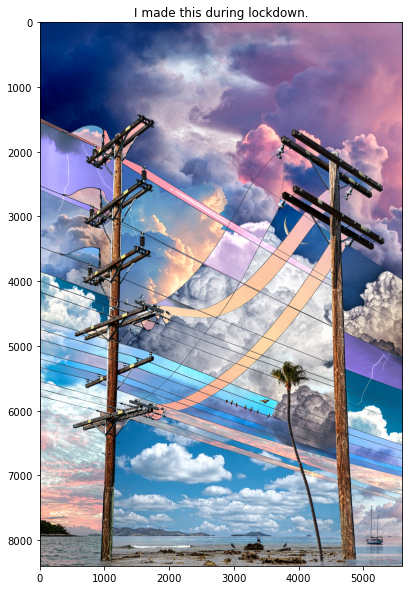

In [190]:
show_random_pic()

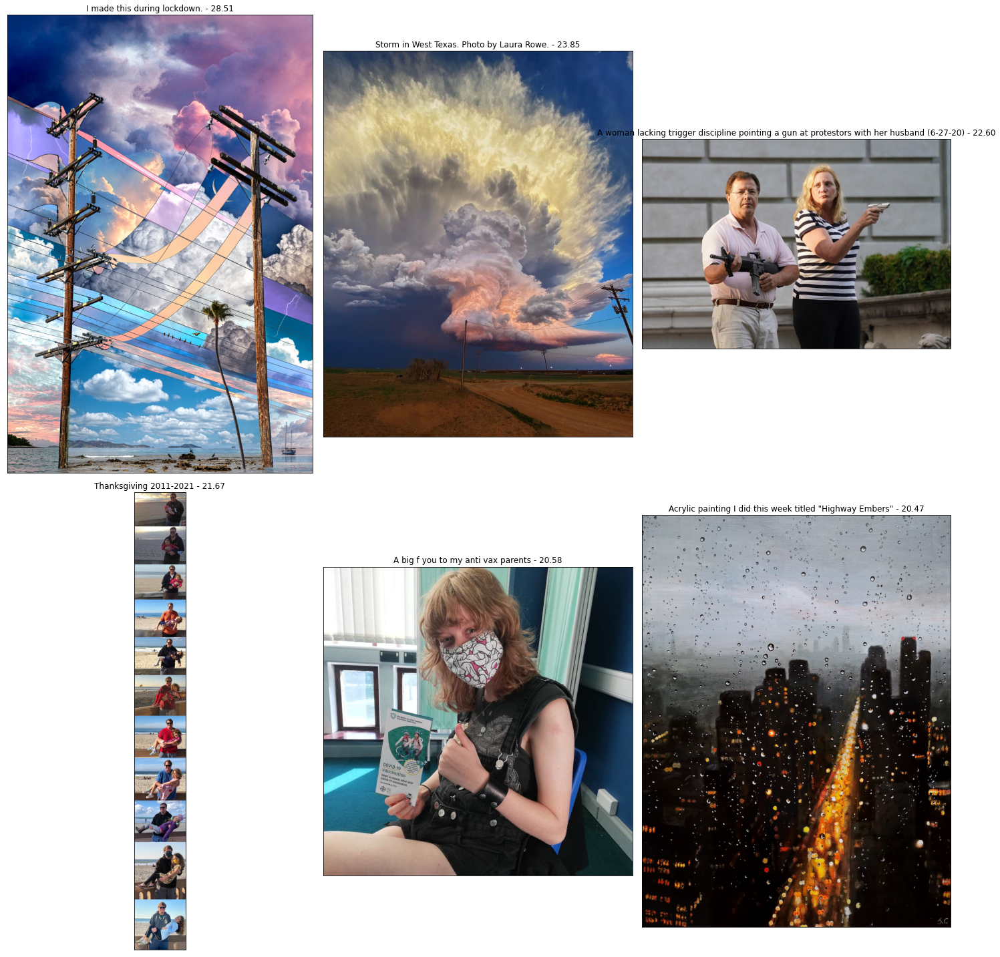

In [221]:
show_top_6_pics_posts("colorful photo of power lines")